## CE263N
## Alvin Zhou and Pietro Achatz Antonelli

### Term Project
### Method for Benchmarking Diffusion of Infectious Disease at an Airport’s Gates Using Bipartite Networks

In [1]:
import skmob
import networkx as nx
import osmnx
import pandas as pd
import numpy as np
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.shapereader as shpreader
import matplotlib.pyplot as plt
import operator
import geopandas as gpd
import os

from pprint import pprint
from matplotlib.lines import Line2D
from collections import Counter
from networkx.algorithms import bipartite

# Data Processing

## Load in gate traffic, import origin airports with lat/long coordinates

In [2]:
q12_2018 = pd.read_excel('AOD 2018 Q1-Q2 Analyzed.xlsx',sheet_name = [0,2])
airport_locs = pd.read_csv('airport-codes_csv.csv')

In [3]:
# separate flights by timestamp
start_time = pd.Timestamp(year=2018, month=1, day=1, hour=0)
end_time = pd.Timestamp(year=2018, month=2, day=12, hour=0)

In [4]:
airport_locs.head()

,ident,type,name,elevation_ft,continent,iso_country,iso_region,municipality,gps_code,iata_code,local_code,coordinates
0,00A,heliport,Total Rf Heliport,11.0,NaN,US,US-PA,Bensalem,00A,NaN,00A,"-74.93360137939453, 40.07080078125"
1,00AA,small_airport,Aero B Ranch Airport,3435.0,NaN,US,US-KS,Leoti,00AA,NaN,00AA,"-101.473911, 38.704022"
2,00AK,small_airport,Lowell Field,450.0,NaN,US,US-AK,Anchor Point,00AK,NaN,00AK,"-151.695999146, 59.94919968"
3,00AL,small_airport,Epps Airpark,820.0,NaN,US,US-AL,Harvest,00AL,NaN,00AL,"-86.77030181884766, 34.86479949951172"
4,00AR,closed,Newport Hospital & Clinic Heliport,237.0,NaN,US,US-AR,Newport,NaN,NaN,NaN,"-91.254898, 35.6087"


In [5]:
airport_icao = airport_locs.set_index('ident')

In [6]:
airport_icao.head()

,type,name,elevation_ft,continent,iso_country,iso_region,municipality,gps_code,iata_code,local_code,coordinates
ident,,,,,,,,,,,
00A,heliport,Total Rf Heliport,11.0,NaN,US,US-PA,Bensalem,00A,NaN,00A,"-74.93360137939453, 40.07080078125"
00AA,small_airport,Aero B Ranch Airport,3435.0,NaN,US,US-KS,Leoti,00AA,NaN,00AA,"-101.473911, 38.704022"
00AK,small_airport,Lowell Field,450.0,NaN,US,US-AK,Anchor Point,00AK,NaN,00AK,"-151.695999146, 59.94919968"
00AL,small_airport,Epps Airpark,820.0,NaN,US,US-AL,Harvest,00AL,NaN,00AL,"-86.77030181884766, 34.86479949951172"
00AR,closed,Newport Hospital & Clinic Heliport,237.0,NaN,US,US-AR,Newport,NaN,NaN,NaN,"-91.254898, 35.6087"


In [7]:
# map states to their abbreviations
abbrev_df = pd.read_csv('./List-of-US-States/states.csv')
state_to_abbrev = dict(zip(list(abbrev_df['State'].values),list(abbrev_df['Abbreviation'].values)))
abbrev_to_state = {v: k for k, v in state_to_abbrev.items()}

In [8]:
abbrev_df.head()

,State,Abbreviation
0,Alabama,AL
1,Alaska,AK
2,Arizona,AZ
3,Arkansas,AR
4,California,CA


In [9]:
clean_flight = q12_2018[0].copy()
archive = q12_2018[2].copy()
clean_flight.loc[3,:]

Combined Tail ID        43101_N34455_82
Terminal                              3
Gate                                 82
Time Arr            2018-01-01 05:03:26
Time Dep            2018-01-01 08:46:32
Tot Time                            223
Airline                 UNITED AIRLINES
Dom or Int                    Passenger
Classification                        N
Type                               B739
Sub Type                   737-924ER(W)
Full Plane Type       B739-737-924ER(W)
Name: 3, dtype: object

In [10]:
test_flight = clean_flight.copy()
clean_flight = test_flight.loc[(test_flight['Time Arr']>start_time) & (test_flight['Time Arr']<end_time),:].copy()
print(test_flight.shape)
print(clean_flight.shape)

(4616, 12)
(4616, 12)


In [11]:
print(clean_flight.shape)

(4616, 12)


In [12]:
# separate timestamp into month, day, hour
archive['Time Arr Hour'] = archive['ACTUAL_AOD_TIME'].apply(lambda x: x.hour)
archive['Time Arr Hour'] = archive['Time Arr Hour'].fillna(-1)
archive['Time Arr Hour'] = archive['Time Arr Hour'].astype(int)
archive['Time Arr Day'] = archive['ACTUAL_AOD_TIME'].apply(lambda x: x.day)
archive['Time Arr Day'] = archive['Time Arr Day'].fillna(-1)
archive['Time Arr Day'] = archive['Time Arr Day'].astype(int)
archive['Time Arr Month'] = archive['ACTUAL_AOD_TIME'].apply(lambda x: x.month)
archive['Time Arr Month'] = archive['Time Arr Month'].fillna(-1)
archive['Time Arr Month'] = archive['Time Arr Month'].astype(int)
archive['Matched'] = archive['Matched'].fillna('FALSE').copy()
# grab all origin airports in dataset
airports = set()
origins = []
dest = []
num_flights = {}
num_dest = {}
for idx in clean_flight.index:
    flight = clean_flight.loc[idx,:]
    tail_id = flight['Combined Tail ID']
    time_arr = flight['Time Arr']
    route = archive.loc[(archive['Time Arr Day'] == time_arr.day) &
                        (archive['Time Arr Hour'] == time_arr.hour) &
                        (archive['Combined Tail ID']==tail_id) &
                        (archive['ARRIVAL_OR_DEPARTURE']=='ARR') , 'ROUTE']
    origin_airport = route.values[0].split(' /')[0]
    
    # repeat for departure flights
    time_dep = flight['Time Dep']
    route = archive.loc[(archive['Time Arr Day'] == time_dep.day) &
                        (archive['Time Arr Hour'] == time_dep.hour) &
                        (archive['Combined Tail ID']==tail_id) &
                        (archive['ARRIVAL_OR_DEPARTURE']=='DEP') , 'ROUTE']
    dest_airport = route.values[0].split(' /')[1]
    dest_airport = dest_airport.split(' ')[0]
    # count number of flights to and from this airport
    try:
        num_flights[origin_airport] = num_flights[origin_airport]+1
        num_dest[dest_airport] = num_dest[dest_airport]+1
    except: # Key is missing
        num_flights[origin_airport] = 1
        num_dest[dest_airport] = 1
    
    origins.append(origin_airport)
    dest.append(dest_airport)
    airports.add(origin_airport)
    airports.add(dest_airport)
# create new column detailing the origin airport
clean_flight['origin'] = origins
clean_flight['destination'] = dest

In [13]:
clean_flight.head()

,Combined Tail ID,Terminal,Gate,Time Arr,Time Dep,Tot Time,Airline,Dom or Int,Classification,Type,Sub Type,Full Plane Type,origin,destination
0,43101_N76523_69,3,69,2018-01-01 04:09:51,2018-01-01 07:49:00,220,UNITED AIRLINES,Passenger,N,B738,737-824(W)(ETOPS),B738-737-824(W)(ETOPS),PHOG,KPHX
1,43101_N77865_85,3,85,2018-01-01 04:47:32,2018-01-01 09:23:23,276,UNITED AIRLINES,Passenger,N,B753,757-33N(W),B753-757-33N(W),PHOG,PHOG
2,43101_N33103_88,3,88,2018-01-01 04:57:37,2018-01-01 09:10:26,253,UNITED AIRLINES,Passenger,N,B752,757-224(W)(ETOPS),B752-757-224(W)(ETOPS),PHLI,PHLI
3,43101_N34455_82,3,82,2018-01-01 05:03:26,2018-01-01 08:46:32,223,UNITED AIRLINES,Passenger,N,B739,737-924ER(W),B739-737-924ER(W),PHKO,KMSY
4,43101_N29907_G96,3,G96,2018-01-01 05:30:08,2018-01-01 11:29:31,359,UNITED AIRLINES,Passenger,W,B788,787-8,B788-787-8,LLBG,RJBB


In [14]:
import copy

# Calculate lat and long for all airports
airports = list(airports)
lat = []
lon = []
origin_state = []
destination_state = []
i = 0
for airport in clean_flight['origin']:
    # get airport coordinates
    try:
        airport_coords = airport_locs.loc[airport_locs['ident']==airport,'coordinates']
        airport_coords = airport_coords.values[0].split(', ')
        lat.append(float(airport_coords[0]))
        lon.append(float(airport_coords[1]))
    except:
        # cannot find airport
        lat.append(np.nan)
        lon.append(np.nan)
    i+=1
a = len(clean_flight.index.values)
airport_map = {}
new_num_flights = copy.copy(num_flights)
for airport in num_flights.keys():
    try:
        airport_coords = airport_locs.loc[airport_locs['ident']==airport,'coordinates']
        airport_coords = airport_coords.values[0].split(', ')
        airport_coords = [float(x) for x in airport_coords]
        airport_map[airport] = airport_coords
    except:
        del new_num_flights[airport]

num_flights = new_num_flights

# drop missing airports
print(len(clean_flight.index.values))
clean_flight['origin_lat'] = lat
clean_flight['origin_lon'] = lon
clean_flight = clean_flight.dropna().copy()
b = len(clean_flight.index.values)
print(f'Number of elements removed: {a-b}')

for airport in clean_flight['origin']:
    try:
        airport_state = airport_icao.loc[airport,'iso_region'] # This returns a string like US-PA --> Pensylvannia
        airport_state = abbrev_to_state[airport_state.split('-')[1]]
        origin_state.append(airport_state)
    except:
        origin_state.append(np.nan)
    
# Repeat for destination column
dest_lat = []
dest_lon = []
new_num_flights = copy.copy(num_flights)
for airport in clean_flight['destination']:
    # get airport coordinates
    try:
        airport_coords = airport_locs.loc[airport_locs['ident']==airport,'coordinates']
        airport_coords = airport_coords.values[0].split(', ')
        dest_lat.append(float(airport_coords[0]))
        dest_lon.append(float(airport_coords[1]))
    except:
        # cannot find airport
        dest_lat.append(np.nan)
        dest_lon.append(np.nan)

for airport in num_dest.keys():
    try:
        airport_coords = airport_locs.loc[airport_locs['ident']==airport,'coordinates']
        airport_coords = airport_coords.values[0].split(', ')
        airport_coords = [float(x) for x in airport_coords]
        airport_map[airport] = airport_coords
    except:
        del new_num_flights[airport]
        
for airport in clean_flight['destination']:
    try:
        airport_state = airport_icao.loc[airport,'iso_region'] # This returns a string like US-PA --> Pensylvannia
        airport_state = abbrev_to_state[airport_state.split('-')[1]]
        destination_state.append(airport_state)
    except:
        destination_state.append(np.nan)
        
# Append results to dataframe
clean_flight['destination_lat'] = dest_lat
clean_flight['destination_lon'] = dest_lon

clean_flight['origin_state'] = origin_state
clean_flight['destination_state'] = destination_state
a = len(clean_flight.index.values)
clean_flight = clean_flight.dropna().copy()
b = len(clean_flight.index.values)
print(f'Number of elements removed: {a-b}')
clean_flight.reset_index(drop = True,inplace=True)

4616
Number of elements removed: 11
Number of elements removed: 520


In [15]:
clean_flight.head()

,Combined Tail ID,Terminal,Gate,Time Arr,Time Dep,Tot Time,Airline,Dom or Int,Classification,Type,Sub Type,Full Plane Type,origin,destination,origin_lat,origin_lon,destination_lat,destination_lon,origin_state,destination_state
0,43101_N76523_69,3,69,2018-01-01 04:09:51,2018-01-01 07:49:00,220,UNITED AIRLINES,Passenger,N,B738,737-824(W)(ETOPS),B738-737-824(W)(ETOPS),PHOG,KPHX,-156.429993,20.898600,-112.012001,33.434299,Hawaii,Arizona
1,43101_N77865_85,3,85,2018-01-01 04:47:32,2018-01-01 09:23:23,276,UNITED AIRLINES,Passenger,N,B753,757-33N(W),B753-757-33N(W),PHOG,PHOG,-156.429993,20.898600,-156.429993,20.898600,Hawaii,Hawaii
2,43101_N33103_88,3,88,2018-01-01 04:57:37,2018-01-01 09:10:26,253,UNITED AIRLINES,Passenger,N,B752,757-224(W)(ETOPS),B752-757-224(W)(ETOPS),PHLI,PHLI,-159.339005,21.976000,-159.339005,21.976000,Hawaii,Hawaii
3,43101_N34455_82,3,82,2018-01-01 05:03:26,2018-01-01 08:46:32,223,UNITED AIRLINES,Passenger,N,B739,737-924ER(W),B739-737-924ER(W),PHKO,KMSY,-156.045603,19.738783,-90.258003,29.993401,Hawaii,Louisiana
4,43101_N879DN_42,1,42,2018-01-01 06:08:43,2018-01-01 08:43:56,155,DELTA AIR LINES,Passenger,N,B739,737-900ER(W),B739-737-900ER(W),PHNL,KMSP,-157.924228,21.320620,-93.221802,44.882000,Hawaii,Minnesota


In [16]:
# Sort incoming traffic by terminal

# Create terminal sets
terminal1 = [str(terminal) for terminal in range(20,49)]
terminal1+=[str(terminal)+'A' for terminal in range(20,49)]
terminal1+=[str(terminal)+'B' for terminal in range(20,49)]
terminal2 = [str(terminal) for terminal in range(50,60)]
terminal2+=[str(terminal)+'A' for terminal in range(50,60)]
terminal2+=[str(terminal)+'B' for terminal in range(50,60)]
terminal3 = [str(terminal) for terminal in range(60,91)]
terminal3+=[str(terminal)+'A' for terminal in range(60,91)]
terminal3+=[str(terminal)+'B' for terminal in range(60,91)]
terminal3+=[str(terminal)+'C' for terminal in range(60,91)]
terminal3+=[str(terminal)+'D' for terminal in range(60,91)]
intG = ['G'+str(terminal) for terminal in range(91,103)]
intA = ['A'+str(terminal) for terminal in range(1,13)]+['A'+str(terminal)+'B' for terminal in range(1,13)]+['A11A']

In [17]:
# Sort gates by terminal
gate_list = set(list(clean_flight['Gate'].apply(lambda x: str(x).split(' ')[0]).values
                    ))
gate_list = sorted(list(gate_list))

gates_in_1 = []
gates_in_2 = []
gates_in_3 = []
gates_in_G = []
gates_in_A = []

gates = [gates_in_1, gates_in_2, gates_in_3, gates_in_A, gates_in_G]
terminals = [terminal1, terminal2, terminal3, intA, intG]
for gate in gate_list:
    idx = 0
    for terminal in terminals:
        if set([gate]).issubset(set(terminals[idx])):
            gates[idx].append(gate)
        idx += 1
        if idx == len(terminals)+1:
            raise Exception()
clean_flight['Gate'] = list(clean_flight['Gate'].apply(lambda x: str(x).split(' ')[0]).values)

In [18]:
terminal_names = ['1','2','3','A','G']
terminal_dict = dict(zip(terminal_names,gates))
gate_map = {}

i = 0
for pair in terminal_dict.values():
    for gate in pair:
        gate_map[gate] = terminal_names[i]
    i+=1
    
mapped_terminal = []
for idx in clean_flight.index:
    mapped_terminal.append(gate_map[str(clean_flight['Gate'].iloc[idx])])
    
clean_flight['terminal'] = mapped_terminal

In [19]:
clean_flight.head()

,Combined Tail ID,Terminal,Gate,Time Arr,Time Dep,Tot Time,Airline,Dom or Int,Classification,Type,...,Full Plane Type,origin,destination,origin_lat,origin_lon,destination_lat,destination_lon,origin_state,destination_state,terminal
0,43101_N76523_69,3,69,2018-01-01 04:09:51,2018-01-01 07:49:00,220,UNITED AIRLINES,Passenger,N,B738,...,B738-737-824(W)(ETOPS),PHOG,KPHX,-156.429993,20.898600,-112.012001,33.434299,Hawaii,Arizona,3
1,43101_N77865_85,3,85,2018-01-01 04:47:32,2018-01-01 09:23:23,276,UNITED AIRLINES,Passenger,N,B753,...,B753-757-33N(W),PHOG,PHOG,-156.429993,20.898600,-156.429993,20.898600,Hawaii,Hawaii,3
2,43101_N33103_88,3,88,2018-01-01 04:57:37,2018-01-01 09:10:26,253,UNITED AIRLINES,Passenger,N,B752,...,B752-757-224(W)(ETOPS),PHLI,PHLI,-159.339005,21.976000,-159.339005,21.976000,Hawaii,Hawaii,3
3,43101_N34455_82,3,82,2018-01-01 05:03:26,2018-01-01 08:46:32,223,UNITED AIRLINES,Passenger,N,B739,...,B739-737-924ER(W),PHKO,KMSY,-156.045603,19.738783,-90.258003,29.993401,Hawaii,Louisiana,3
4,43101_N879DN_42,1,42,2018-01-01 06:08:43,2018-01-01 08:43:56,155,DELTA AIR LINES,Passenger,N,B739,...,B739-737-900ER(W),PHNL,KMSP,-157.924228,21.320620,-93.221802,44.882000,Hawaii,Minnesota,1


In [20]:
clean_flight.to_csv('AOD_2018_q1-263.csv')

C:\Users\orcal\.conda\envs\skmob\lib\site-packages\cartopy\mpl\geoaxes.py:388: MatplotlibDeprecationWarning: 
The 'inframe' parameter of draw() was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use Axes.redraw_in_frame() instead. If any parameter follows 'inframe', they should be passed as keyword, not positionally.
  inframe=inframe)


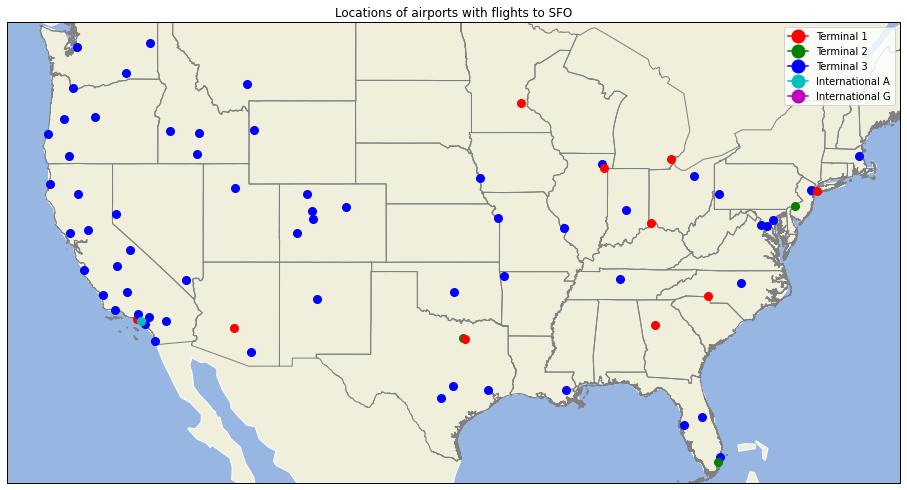

In [21]:
# Plot majority terminal for each gate in continental United States
vals = list(airport_map.values())
airport_lat = [x[1] for x in vals]
airport_lon = [x[0] for x in vals]
color_palette = ['r','g','b','c','m']
terminal_color = dict(zip(terminal_names,color_palette))
plt.figure(figsize=(16, 12))
ax = plt.axes(projection=ccrs.Mercator())

custom_lines = [Line2D([0], [0], marker='o', color='r', markersize=13),
                Line2D([0], [0], marker='o', color='g', markersize=13),
                Line2D([0], [0], marker='o', color='b', markersize=13),
                Line2D([0], [0], marker='o', color='c', markersize=13),
                Line2D([0], [0], marker='o', color='m', markersize=13)
                ]


for airport in airport_map.keys():
    if (airport[0] != 'K'):
        continue
        
    # Find terminal where the majority of flights go to
    airport_terminal = Counter(list(clean_flight['terminal'].loc[clean_flight['origin']==airport].values))
    airport_terminal = max(airport_terminal,key = airport_terminal.get)
    
    num_flights_to_airport = num_flights[airport]
    color = terminal_color[airport_terminal]
    plt.plot(airport_map[airport][0],airport_map[airport][1],color=color,marker='.', markersize=16, label=airport_terminal,
     transform=ccrs.Geodetic()
     )
#     plt.text(airport_map[airport][0],airport_map[airport][1]+0.01,airport,transform=ccrs.Geodetic())
# ax.stock_img()
ax.add_feature(cartopy.feature.OCEAN, zorder=0)
ax.add_feature(cartopy.feature.LAND, zorder=0, edgecolor='white')
us_shapes = list(shpreader.Reader('gadm36_USA_1.shp').geometries())
ax.add_geometries(us_shapes, ccrs.PlateCarree(), edgecolor='gray',
              facecolor='none')
plt.title('Locations of airports with flights to SFO')
plt.legend(custom_lines, ['Terminal 1', 'Terminal 2', 'Terminal 3','International A', 'International G'])
plt.savefig('cont_airports.png')
plt.show()

# Create network

In [22]:
# Import COVID data
filepath = r'C:\Users\orcal\Documents\UCB\CE263N\Project\COVID-19\csse_covid_19_data\csse_covid_19_daily_reports_us'
covid_19_filenames = os.listdir(filepath)
new_names = []
date_names = [filename.split('.')[0] for filename in covid_19_filenames]
for path in covid_19_filenames:
    new_path = os.path.join(filepath,path)
    new_names.append(new_path)
    
covid_19_filenames = new_names

# Drop regions that are not covered in the entire dataset
state_incidence_rate = []
for csv_file in covid_19_filenames:
    df = pd.read_csv(csv_file)
    df.set_index('Province_State',inplace=True)
    try:
        df.drop(['American Samoa'],axis=0,inplace=True)
    except:
        pass
    
    try:
        df.drop(['Recovered'],axis=0,inplace=True)
    except:
        pass
    
    try:
        df.drop(['Virgin Islands'],axis=0,inplace=True)
    except:
        pass
    state_incidence_rate.append(list(df['Incident_Rate'].values))
    
# Rename index to state names
last_df = df
state_index = list(last_df.index)
incidence_df = pd.DataFrame(state_incidence_rate).T
incidence_df.columns = date_names
incidence_df.drop(list(incidence_df.index[-2:]))
incidence_df.index = state_index

In [23]:
# map states to their abbreviations
abbrev_df = pd.read_csv('./List-of-US-States/states.csv')
state_to_abbrev = dict(zip(list(abbrev_df['State'].values),list(abbrev_df['Abbreviation'].values)))
abbrev_to_state = {v: k for k, v in state_to_abbrev.items()}
abbrev_df.head()

,State,Abbreviation
0,Alabama,AL
1,Alaska,AK
2,Arizona,AZ
3,Arkansas,AR
4,California,CA


In [24]:
incidence_df.tail()

,04-12-2020,04-13-2020,04-14-2020,04-15-2020,04-16-2020,04-17-2020,04-18-2020,04-19-2020,04-20-2020,04-21-2020,...,11-23-2020,11-24-2020,11-25-2020,11-26-2020,11-27-2020,11-28-2020,11-29-2020,11-30-2020,12-01-2020,12-02-2020
Virginia,140.527668,72.680319,78.181614,82.203249,87.122798,94.736083,101.843503,108.027716,113.693417,121.787276,...,2589.625774,2619.430640,2651.274047,2681.734995,2699.824111,2736.998184,2764.237301,2786.415214,2812.517903,2840.834869
Washington,44.822441,140.872066,143.044424,144.938613,146.461912,152.555109,155.985844,162.330717,160.463019,166.410510,...,1937.479621,1983.205805,2021.118353,2021.118353,2077.074491,2109.471532,2136.602576,2167.056057,2195.907415,2236.958550
West Virginia,64.565739,46.182987,48.374979,53.061305,55.026538,58.579076,59.334935,67.271455,68.178486,68.632001,...,2294.119846,2348.189072,2402.146699,2465.199562,2513.521491,2558.104888,2622.385329,2669.535479,2723.995297,2784.648804
Wisconsin,54.299735,66.247038,68.701347,71.909343,74.885435,78.325334,81.146824,83.987639,86.944406,89.379390,...,6521.207454,6637.104002,6740.102163,6837.415418,6861.838193,6955.836683,7025.481096,7071.441256,7151.047139,7229.450776
Wyoming,19.947773,55.305285,56.713056,57.718607,59.528598,61.338589,62.143030,62.947470,63.751911,89.091787,...,5085.190900,5176.420583,5314.992942,5314.992942,5489.849834,5516.631275,5613.562813,5754.554141,5840.945886,5959.475360


In [25]:
california_incidence = incidence_df.loc['California',:].to_numpy()
alabama_incidence = incidence_df.loc['Alabama',:].to_numpy()
florida_incidence = incidence_df.loc['Florida',:].to_numpy()
ny_incidence = incidence_df.loc['New York',:].to_numpy()

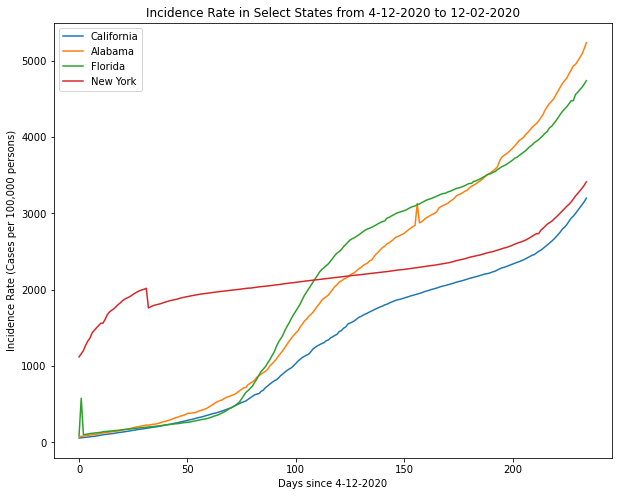

In [26]:
plt.figure(figsize=(10,8))
plt.plot(california_incidence,label='California')
plt.plot(alabama_incidence,label='Alabama')
plt.plot(florida_incidence,label='Florida')
plt.plot(ny_incidence,label='New York')
plt.title('Incidence Rate in Select States from 4-12-2020 to 12-02-2020')
plt.xlabel('Days since 4-12-2020')
plt.ylabel('Incidence Rate (Cases per 100,000 persons)')
plt.legend()
plt.savefig('incidence_compare.png')
plt.show()

In [27]:
graph = nx.DiGraph()

# Remove all airports not in the continental United States
all_airports = set(list(clean_flight['origin'].values)+list(clean_flight['destination'].values))
cont_airports = set()
for airport in all_airports:
    if airport[0] == 'K':
        cont_airports.add(airport)
# bipartite = 0 for gate nodes
# bipartite = 1 for airport nodes

# add nodes with risk factor attribute
gate_nodes = []
for gate in gate_list:
    node = (gate,{'weight':1,'bipartite':0})
    gate_nodes.append(node)
graph.add_nodes_from(gate_nodes)
graph.add_nodes_from(all_airports,bipartite=1)


In [28]:
origin_pairs = list(zip(clean_flight.Gate,clean_flight.origin))
destination_pairs = list(zip(clean_flight.Gate,clean_flight.destination))

origin_set = set(origin_pairs)
destination_set = set(destination_pairs)

origin_count = {}
destination_count = {}

for origin in origin_pairs:
    try:
        origin_count[origin]+=1
    except:
        origin_count[origin]=1

for destination in destination_pairs:
    try:
        destination_count[destination]+=1
    except:
        destination_count[destination]=1
        
# add edges between gates and airports in the continental United States
for origin in origin_set:
    #weight = origin_count[origin]
#     if origin[1][0] != 'K':
#         continue
    weight=1
    graph.add_edge(origin[1],origin[0],weight=weight)
    
for destination in destination_set:
#     if destination[1][0] != 'K':
#         continue
    #weight = destination_count[destination]
    weight=1
    graph.add_edge(destination[0],destination[1],weight=weight)

In [29]:
nx.is_bipartite(graph)

True

In [30]:
# remove disconnected nodes
def trim_nodes(G):
    deg = G.degree()
    to_keep = []
    for node in G.nodes():
        if deg[node] != 0:
            to_keep.append(node)
        else:
            pass
            #print("Node: ",node," degree: ",deg[node])
    #Create the network only with connected nodes
    G=G.subgraph(to_keep)
    return G

graph = trim_nodes(graph)

## Bipartite set projections

### Get projections for gate set and airport set

In [31]:
# Projection onto gates
def proj_function(graph, node_u, node_v, weight="weight"):
    pass
    return # int or float
top = nx.bipartite.sets(graph)[0]
bot = nx.bipartite.sets(graph)[1]
gate_proj = bipartite.projected_graph(graph, top)
airport_proj = bipartite.projected_graph(graph, bot)
# Projection onto airports

In [32]:
# Map time series of incidence rates to airports
day = '09-25-2020'
origin_incidence = []
destination_incidence = []

# test for valid date
try:
    incidence_df.loc['California',day]
except:
    print('Invalid Date!')
for state in clean_flight['origin_state']:
    origin_incidence.append(incidence_df.loc[state,day])
    
for state in clean_flight['destination_state']:
    destination_incidence.append(incidence_df.loc[state,day])
    
clean_flight['origin_incidence'] = origin_incidence
clean_flight['destination_incidence'] = destination_incidence
clean_flight['mixing_rate_1'] = clean_flight['origin_incidence']/clean_flight['destination_incidence']
clean_flight['mixing_rate_2'] = clean_flight['destination_incidence']/clean_flight['origin_incidence']
clean_flight['mixing_rate'] = clean_flight[['mixing_rate_1','mixing_rate_2']].max(axis=1)
clean_flight['mixing_rate'] = clean_flight['mixing_rate'].abs()

In [33]:
all_pairs = list(set(airport_proj.edges))
all_pairs.sort()
pair_mix_rate = {}
icao_mix_rate = {}
for pair in all_pairs:
    origin = pair[0]
    destination = pair[1]
    valid_flights = (clean_flight['origin']==origin) & (clean_flight['destination']==destination)
    if valid_flights.any():
        first_valid = valid_flights.argmax()
        pair_mix_rate[pair] = clean_flight.loc[first_valid,'mixing_rate']
        icao_mix_rate[pair] = clean_flight.loc[first_valid,'mixing_rate']
    else:
        pair_mix_rate[pair] = 0
        icao_mix_rate[pair] = 0

In [34]:
# calculate mixing rate for each gate
gate_mix_risk = {}
for gate in gate_list:
    # get all flights going through a specific gate
    flights_through_gate = clean_flight.loc[clean_flight['Gate']==gate,:]
    
    # now get all unique origin-destination pairs
    unique_flight_pairs = set(list(zip(flights_through_gate['origin'].values,
                                       flights_through_gate['destination'].values)))
    gate_risks = np.array([])
    for pair in unique_flight_pairs:
        # determine the mixing rate for each pair
        if pair[0] == pair[1]:
            pair_risk = 0
        else:
            pair_risk = pair_mix_rate[pair]
        gate_risks = np.append(gate_risks,pair_risk)
        
    if np.sum(gate_risks) == 0:
        gate_mix_risk[gate] = 1.0
    else:
        gate_mix_risk[gate] = np.sum(gate_risks)

In [36]:
clean_flight['Gate'] = clean_flight['Gate'].astype('str')

In [37]:
clean_flight['Gate'].values[0]

'69'

In [38]:
gate_mix_df = pd.DataFrame.from_dict(gate_mix_risk, orient='index')
gate_mix_df.columns=['Mixing_Risk']
gate_mix_df.sort_values(by='Mixing_Risk',inplace=True,ascending=False) 

In [39]:
gate_mix_df.head()

,Mixing_Risk
77B,139.077434
84D,131.672557
63,131.182955
77A,118.115084
76,113.032459


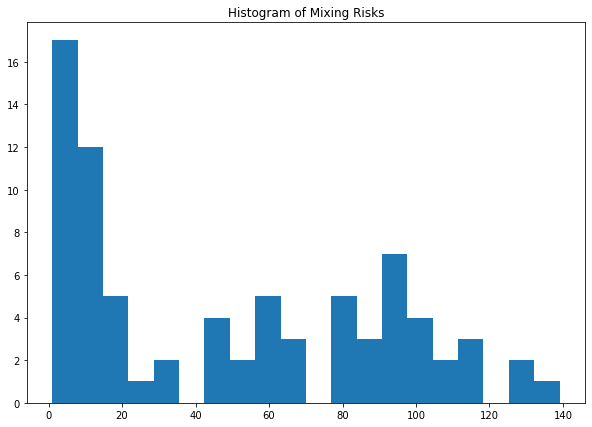

In [40]:
gate_mix_df.hist(column='Mixing_Risk',bins=20,grid=False,figsize=(10,7))
plt.title('Histogram of Mixing Risks')
plt.savefig('hist_mix.png')

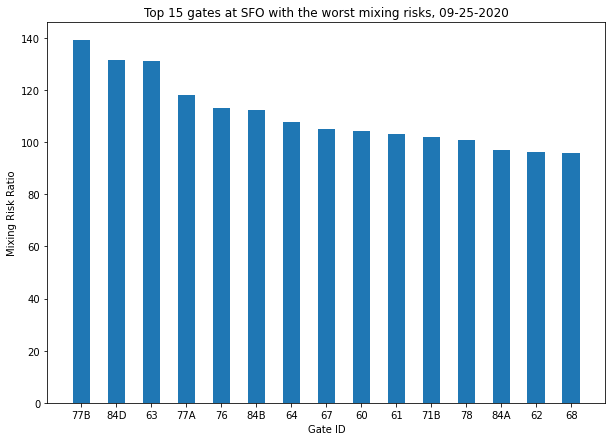

In [41]:
top_n = 15 # get top 10 worst risk gates
labels = list(gate_mix_df.index.values)[0:top_n]
risks = list(gate_mix_df.Mixing_Risk.values)[0:top_n]
x = np.arange(len(labels))
width = 0.5

fig, ax = plt.subplots(figsize=(10,7))
rects1 = ax.bar(x, risks, width,color = 'tab:blue')
ax.set_ylabel('Mixing Risk Ratio')
ax.set_xlabel('Gate ID')
ax.set_title(f'Top {top_n} gates at SFO with the worst mixing risks, {day}')
ax.set_xticks(x)
ax.set_xticklabels(labels)
plt.savefig('top_mix_risk.png')
plt.show()

In [42]:
flights_through_gate['mixing_rate'].sum()

1.004963123542546

In [43]:
gate_nodes = list(gate_proj.nodes)
gate_nodes.sort()

In [44]:
print(gate_nodes)

['22', '23', '24', '25', '26', '27', '28', '40', '41', '42', '43', '44', '45A', '45B', '46', '47', '48', '50A', '50B', '51A', '51B', '52', '53', '54A', '54B', '55', '56A', '56B', '57', '58A', '58B', '59A', '60', '61', '62', '63', '64', '65', '66', '67', '68', '69', '70', '71A', '71B', '72', '73', '73A', '74', '75', '76', '77A', '77B', '77C', '78', '79', '80', '81', '82', '83', '84A', '84B', '84C', '84D', '85', '86', '87', '88', '89', '90', 'A10', 'A12', 'A2', 'A4', 'A6', 'A8', 'A9', 'G93']


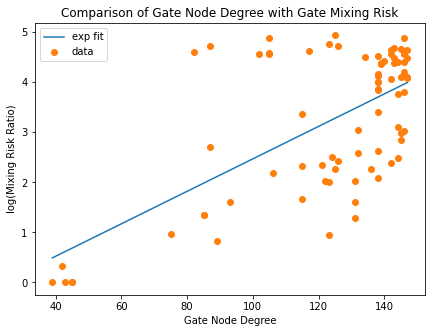

In [45]:
import scipy as sp
import scipy.optimize

node_degree = []
for gate in gate_mix_df.index.values:
    node_degree.append(gate_proj.degree[gate])
    
gate_mix_df['Gate_Node_Degree'] = node_degree

def model_func(x,a,b):
    return a*x+b

def fit_exp_nonlinear(t, y):
    opt_parms, parm_cov = sp.optimize.curve_fit(model_func, t, y, maxfev=10000, p0 = [1,1])
    a,b = opt_parms
    return a,b

def exp_model_func(x,a,b):
    return np.exp(a*x)*np.exp(b)

plt.figure(figsize=(7,5))
ax1 = plt.axes()
data = gate_mix_df[['Gate_Node_Degree','Mixing_Risk']].sort_values(by='Gate_Node_Degree')
# data['Mixing_Risk'] = np.log(data['Mixing_Risk'])
x = data['Gate_Node_Degree'].to_numpy()
y = data['Mixing_Risk'].to_numpy()
a,b = fit_exp_nonlinear(x,np.log(y))
fit_y = model_func(x,a,b)
plt.plot(x, fit_y,label='exp fit')
plt.plot(gate_mix_df['Gate_Node_Degree'],np.log(gate_mix_df['Mixing_Risk']),'o',label='data')
ax1.set_title('Non-linear Fit')

# fit exp curve
# fit_params = np.polyfit(gate_mix_df['Gate_Node_Degree'].to_numpy(),np.log(gate_mix_df['Mixing_Risk'].to_numpy()), 1)
# y = np.exp(fit_params[0] * (gate_mix_df['Gate_Node_Degree'].to_numpy()))*np.exp(fit_params[1])
# plt.plot(gate_mix_df['Gate_Node_Degree'],np.log(gate_mix_df['Mixing_Risk']),'o')
# plt.plot(gate_mix_df['Gate_Node_Degree'].sort_values(),np.sort(y))
plt.xlabel('Gate Node Degree')
plt.ylabel('log(Mixing Risk Ratio)')
plt.title('Comparison of Gate Node Degree with Gate Mixing Risk')
plt.legend()
plt.savefig('degree_log_risk.png',bbox_inches = "tight")
plt.show()

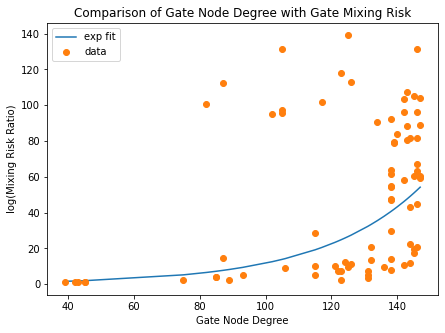

In [46]:
plt.figure(figsize=(7,5))
ax1 = plt.axes()
fit_y = exp_model_func(x,a,b)
plt.plot(x, fit_y,label='exp fit')
plt.plot(gate_mix_df['Gate_Node_Degree'],gate_mix_df['Mixing_Risk'],'o',label='data')
plt.legend()
plt.xlabel('Gate Node Degree')
plt.ylabel('log(Mixing Risk Ratio)')
ax1.set_title('Comparison of Gate Node Degree with Gate Mixing Risk')
plt.savefig('degree_risk.png',bbox_inches = "tight")
plt.show()

In [48]:
data.iloc[0:10,:]

,Gate_Node_Degree,Mixing_Risk
A4,39,1.000000
A6,42,1.389082
G93,43,1.004963
A9,45,1.000000
A8,45,1.000000
A2,75,2.630715
78,82,100.675463
A10,85,3.872348
A12,85,3.872348
86,87,14.809642


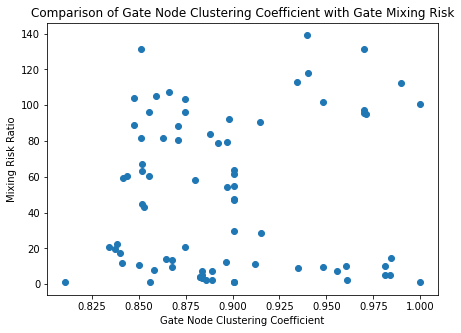

In [49]:
node_degree = []
clustering = nx.clustering(gate_proj)
for gate in gate_mix_df.index.values:
    node_degree.append(clustering[gate])
    
gate_mix_df['Gate_Node_CC'] = node_degree

plt.figure(figsize=(7,5))
plt.scatter(gate_mix_df['Gate_Node_CC'],gate_mix_df['Mixing_Risk'])
plt.xlabel('Gate Node Clustering Coefficient')
plt.ylabel('Mixing Risk Ratio')
plt.title('Comparison of Gate Node Clustering Coefficient with Gate Mixing Risk')
plt.savefig('cc_risk.png')
plt.show()

In [50]:
data = gate_mix_df[['Gate_Node_Degree','Mixing_Risk']].sort_values(by='Gate_Node_Degree')

In [52]:
clean_flight.head()

,Combined Tail ID,Terminal,Gate,Time Arr,Time Dep,Tot Time,Airline,Dom or Int,Classification,Type,...,destination_lat,destination_lon,origin_state,destination_state,terminal,origin_incidence,destination_incidence,mixing_rate_1,mixing_rate_2,mixing_rate
0,43101_N76523_69,3,69,2018-01-01 04:09:51,2018-01-01 07:49:00,220,UNITED AIRLINES,Passenger,N,B738,...,-112.012001,33.434299,Hawaii,Arizona,3,839.835804,2972.598055,0.282526,3.539499,3.539499
1,43101_N77865_85,3,85,2018-01-01 04:47:32,2018-01-01 09:23:23,276,UNITED AIRLINES,Passenger,N,B753,...,-156.429993,20.898600,Hawaii,Hawaii,3,839.835804,839.835804,1.000000,1.000000,1.000000
2,43101_N33103_88,3,88,2018-01-01 04:57:37,2018-01-01 09:10:26,253,UNITED AIRLINES,Passenger,N,B752,...,-159.339005,21.976000,Hawaii,Hawaii,3,839.835804,839.835804,1.000000,1.000000,1.000000
3,43101_N34455_82,3,82,2018-01-01 05:03:26,2018-01-01 08:46:32,223,UNITED AIRLINES,Passenger,N,B739,...,-90.258003,29.993401,Hawaii,Louisiana,3,839.835804,3526.247883,0.238167,4.198735,4.198735
4,43101_N879DN_42,1,42,2018-01-01 06:08:43,2018-01-01 08:43:56,155,DELTA AIR LINES,Passenger,N,B739,...,-93.221802,44.882000,Hawaii,Minnesota,1,839.835804,1670.126703,0.502858,1.988635,1.988635


In [53]:
gate_mix_df.head()

,Mixing_Risk,Gate_Node_Degree,Gate_Node_CC
77B,139.077434,125,0.939597
84D,131.672557,105,0.969969
63,131.182955,146,0.851042
77A,118.115084,123,0.940035
76,113.032459,126,0.934101


To use skmob's FlowDataFrame, we need to map the gate and airport names to integer IDs

In [54]:
gate_edges = list(gate_proj.edges(data=True))

In [55]:
gate_df = pd.read_excel('gate_coords.xlsx')
gate_df = gate_df.dropna().copy()
gate_df.reset_index(inplace=True,drop=True)

In [56]:
gate_df['loc'] = gate_df['loc'].apply(lambda x: list(x.split(', ')))

In [57]:
gate_df['long'] = gate_df['loc'].apply(lambda x: float(x[1]))
gate_df['lat'] = gate_df['loc'].apply(lambda x: float(x[0]))

In [58]:
gate_df.head()

,gate,loc,long,lat
0,20,"[37.61391155436734, -122.38543787963708]",-122.385438,37.613912
1,21,"[37.61391334101065, -122.38491912385682]",-122.384919,37.613913
2,22,"[37.61352805858318, -122.3853107748032]",-122.385311,37.613528
3,23,"[37.61346431755819, -122.38473007655958]",-122.384730,37.613464
4,24,"[37.613539324514264, -122.38531143607227]",-122.385311,37.613539


In [59]:
comb_df_1 = gate_df.copy()
comb_df_1.drop(['loc'],axis=1,inplace=True)

In [60]:
comb_df_1.rename({"gate":"location"},inplace=True,axis='columns')
comb_df_1.head()

,location,long,lat
0,20,-122.385438,37.613912
1,21,-122.384919,37.613913
2,22,-122.385311,37.613528
3,23,-122.384730,37.613464
4,24,-122.385311,37.613539


In [61]:
cont_map = copy.copy(airport_map)

In [62]:
# Check that all airport nodes are in the airport mapping to coordinates
airport_nodes = list(airport_proj.nodes)
airport_nodes.sort()

# if true, all nodes are in the airport mapping
print(Counter(airport_nodes) == Counter(list(cont_map.keys())))

False


In [63]:
airport_df = pd.DataFrame.from_dict(cont_map).T
airport_df.reset_index(inplace=True)
airport_df.columns = ['location','long','lat']

In [64]:
airport_df.head()

,location,long,lat
0,PHOG,-156.429993,20.898600
1,PHLI,-159.339005,21.976000
2,PHKO,-156.045603,19.738783
3,LLBG,34.886700,32.011398
4,YSSY,151.177002,-33.946098


In [65]:
comb_df = pd.concat([comb_df_1,airport_df],ignore_index=True)

In [66]:
comb_df.head()

,location,long,lat
0,20,-122.385438,37.613912
1,21,-122.384919,37.613913
2,22,-122.385311,37.613528
3,23,-122.384730,37.613464
4,24,-122.385311,37.613539


In [67]:
comb_df['location'] = comb_df['location'].astype('str')
location_id = set(list(comb_df['location'].values))
location_id = list(location_id)
location_id.sort()

In [68]:
# Map names to integer IDs
location_map = {}
for i in range(len(location_id)):
    location_map[location_id[i]] = i+1

def map_col(df,col_name,map):
    new_locs = []
    for location in df[col_name].values:
        new_locs.append(location_map[location])
    
    df[col_name] = new_locs 
    return df
                  
comb_df = map_col(comb_df,'location',location_map)

In [69]:
# convert edge view to list of lists with [source, dest, **edge_attr]
# specify edge_attr to extract with list of strings corresponding to edge attributes
def edge_view_to_list(graph,edge_attr=None):
    edge_view = list(graph.edges(data=True))
    edge_list = []
    for edge in edge_view:
        source = edge[0]
        dest = edge[1]
        attrs = []
        if edge_attr is None:
            pass
        else:
            for attr in edge_attr:
                attrs.append(edge[2][attr])
        edge_list.append([source,dest]+attrs)
    return edge_list
     
edge_list = edge_view_to_list(graph,edge_attr=['weight'])

flow_df = pd.DataFrame(edge_list,columns = ['origin','destination','flow'])

# dataframe for building a FlowDataFrame for the whole bipartite network
flow_df = map_col(flow_df,'origin',location_map)
flow_df = map_col(flow_df,'destination',location_map)


In [70]:
gate_proj_edge_list = edge_view_to_list(gate_proj)
airport_proj_edge_list = edge_view_to_list(airport_proj)

# dataframe for building a FlowDataFrame for the bipartite projected gate nodes network
gate_proj_df = pd.DataFrame(gate_proj_edge_list,columns=['origin','destination'])
gate_proj_df['flow'] = 1
gate_proj_df = map_col(gate_proj_df,'origin',location_map)
gate_proj_df = map_col(gate_proj_df,'destination',location_map)

# dataframe for building a FlowDataFrame for the bipartite projected airport nodes network
airport_proj_df = pd.DataFrame(airport_proj_edge_list,columns=['origin','destination'])
airport_weighted_df = airport_proj_df.copy()
airport_proj_df['flow'] = 1
airport_proj_df = map_col(airport_proj_df,'origin',location_map)
airport_proj_df = map_col(airport_proj_df,'destination',location_map)

weighted_flow = []

for idx in airport_weighted_df.index:
    origin = airport_weighted_df.loc[idx,'origin']
    destination = airport_weighted_df.loc[idx,'destination']
    weighted_flow.append(icao_mix_rate[(origin,destination)])

In [71]:
airport_weighted_df['flow'] = weighted_flow
airport_weighted_df = map_col(airport_weighted_df,'origin',location_map)
airport_weighted_df = map_col(airport_weighted_df,'destination',location_map)

In [72]:
airport_weighted_df.head()

,origin,destination,flow
0,147,179,0.000000
1,147,186,0.000000
2,147,180,0.000000
3,147,176,0.000000
4,147,170,1.250539


In [73]:
flow_df.head()

,origin,destination,flow
0,3,160,1
1,3,145,1
2,3,131,1
3,3,164,1
4,4,195,1


In [74]:
# geoDataFrame contains all the coordinate point locations for eacb gate/airport
gdf = gpd.GeoDataFrame(comb_df, geometry = gpd.points_from_xy(comb_df.long, comb_df.lat))

In [75]:
# create flowDataFrame with edge data using whole bipartite graph or its projections
fdf = skmob.FlowDataFrame(flow_df,tessellation = gdf,tile_id = 'location')
gate_proj_fdf = skmob.FlowDataFrame(gate_proj_df,tessellation = gdf,tile_id = 'location')
airport_proj_fdf = skmob.FlowDataFrame(airport_proj_df,tessellation = gdf,tile_id = 'location')
airport_weighted_fdf = skmob.FlowDataFrame(airport_weighted_df,tessellation = gdf,tile_id = 'location')

C:\Users\orcal\.conda\envs\skmob\lib\site-packages\scikit_mobility-1.0-py3.7.egg\skmob\core\flowdataframe.py:145: UserWarning: The tessellation crs is None. It will be set to the default crs WGS84 (EPSG:4326).


In [76]:
fdf.plot_flows(flow_color='red',flow_weight=0.8)

In [77]:
gate_proj_fdf.plot_flows(flow_color='cadetblue',opacity=0.5,flow_weight=0.2)

In [78]:
airport_proj_fdf.plot_flows(flow_color='green',opacity=0.5,flow_weight=0.2)

In [79]:
airport_weighted_fdf.plot_flows(flow_color='red',flow_weight=0.35)

In [80]:
airport_weighted_fdf.head()

,origin,destination,flow
0,147,179,0.000000
1,147,186,0.000000
2,147,180,0.000000
3,147,176,0.000000
4,147,170,1.250539


In [81]:
flow_df.head() # flows are edge weights

,origin,destination,flow
0,3,160,1
1,3,145,1
2,3,131,1
3,3,164,1
4,4,195,1


In [82]:
nx.write_gexf(graph,'airport_graph.gexf')